# 🌴 **Oil Palm Tree Health Detection from Drone Imagery Using YOLO11**

## 🌌 **Group Members:**

1. Muhammad Naqib Syahmi bin Ab Razak (23073950)
2. Madina Suraya binti Zharin (24071524)
3. Liang Shengbao (24200736)
4. Long Yun (24213952)
5. Md Tipu Sultan (24072590)

## **🎯 Data Mining Goal**

1. Develop an object detection model capable of detecting individual oil palm trees in RGB drone imagery and assigning a health label (Healthy or Unhealthy) based on canopy characteristics.

2. Analyze and interpret the visual patterns by the model to understand which canopy-level features contribute to distinguishing between healthy and unhealthy oil palm trees.

## 💯 **Success Criteria**

1. **Detection Performance**

*   Achieves a mean Average Precision at IoU 0.5 (mAP50) of at least 70%
*   Successfully detects at least 70% of visible oil palm trees in RGB drone imagery

2. **Classification Performance**

*   Achieves Precision >= 70% for health classification
*   Achieves Recall >= 70% for the Unhealthy class
*   Achives an overall F1-score >= 70%
*   Maintains a False Negative Rate (Unhealthy) <= 30%

3. **Model Interpretability**

*   Produces meaningful Grad-CAM visualizations that highlights relevant canopy-level features influencing predictions.

*   Highlights relevant canopy features such as:
    *   Canopy color variation
    *   Structural or textual irregularities

*   Provides qualitative insights into how visual canopy characteristics influence health classification decisions














## 🎛️ **Preliminaries**

In [12]:
# Supress Warnings
import warnings
warnings.filterwarnings('ignore')

# Visualization
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns

# Data Science
import numpy as np
import pandas as pd

# Others
import os
import shutil
import random

# Deep Learning
from PIL import Image

import torch
import torch.optim as optim
import torchvision
import torchvision.transforms as T
import torchvision.transforms.functional as F

from torch.utils.data import Dataset, DataLoader
from torch.utils.data import DataLoader, WeightedRandomSampler
from torchvision.ops import box_iou
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# Object Detection
import cv2
import ultralytics

In [ ]:
# Load raw data
base_dir = os.path.dirname(os.getcwd())
data_dir = os.path.join(base_dir, "data")

if not os.path.exists(data_dir):
    raise FileNotFoundError("Data directory not found.")

dataset_dir = os.path.join(data_dir, "Oil-Palm-Health-Detection-2")

# Create dataset folder if it doesn't exist
os.makedirs(dataset_dir, exist_ok=True)

splits = ["train", "valid", "test", "data.yaml", "README.dataset.txt", "README.roboflow.txt"]

for split in splits:
    src = os.path.join(data_dir, split)
    dst = os.path.join(dataset_dir, split)

    if os.path.exists(src):
        if os.path.exists(dst):
            raise FileExistsError(f"{dst} already exists.")
        
        shutil.move(src, dst)

    else:
        print(f"[WARNING] {src} does not exist. Skipping...")

print("Dataset prepared successfully.")


In [ ]:
# Load raw data
base_dir = os.path.dirname(os.getcwd())
raw_data_dir = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2")

# Train
train_path = os.path.join(data_dir, "train")
train_images_path = os.path.join(train_path, "images")
train_label_path = os.path.join(train_path, "labels")

# Valid
valid_path = os.path.join(raw_data_dir, "valid")
valid_images_path = os.path.join(valid_path, "images")
valid_label_path = os.path.join(valid_path, "labels")

# Test
test_path = os.path.join(raw_data_dir, "test")
test_images_path = os.path.join(test_path, "images")
test_label_path = os.path.join(test_path, "labels")


In [ ]:
# Load cleaned data to skip model training

# !unzip ../data/Oil-Palm-Health-Detection-2_new.zip -d ../data/

In [ ]:
# Load clean data
base_dir = os.path.dirname(os.getcwd())
clean_data_dir = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2_new")

# New Train
new_train_path = os.path.join(clean_data_dir, "new_train")
new_train_images_path = os.path.join(new_train_path, "images")
new_train_label_path = os.path.join(new_train_path, "labels")

# New Valid
new_valid_path = os.path.join(clean_data_dir, "new_valid")
new_valid_images_path = os.path.join(new_valid_path, "images")
new_valid_label_path = os.path.join(new_valid_path, "labels")

# New Test
new_test_path = os.path.join(clean_data_dir, "new_test")
new_test_images_path = os.path.join(new_test_path, "images")
new_test_label_path = os.path.join(new_test_path, "labels")

## 📊 **Exploratory Data Analysis (EDA)**

In [16]:
healthy_count = 0
unhealthy_count = 0

# Loop through all annotation files
for label_file in os.listdir(train_label_path):

  if label_file.endswith(".txt"):
    with open(os.path.join(train_label_path, label_file), "r") as f:

      for line in f.readlines():
        class_id = int(line.split()[0])

        if class_id == 0:
          healthy_count += 1

        elif class_id == 1:
          unhealthy_count += 1

print("Healthy oil palm trees: ", healthy_count)
print("Unhealthy oil palm trees: ", unhealthy_count)

Healthy oil palm trees:  104331
Unhealthy oil palm trees:  1563


Pie chart showing the ratio of training images by health category (Healthy and Unhealthy)

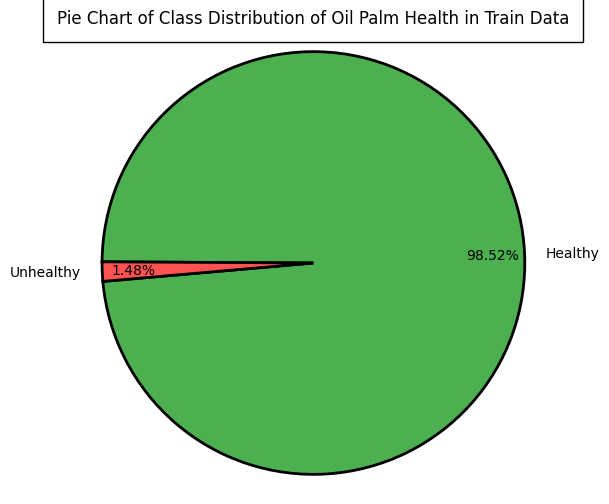

In [17]:
sizes = [healthy_count, unhealthy_count]
colors = ['#4CAF50', '#FF5252']

plt.figure(figsize=(6,6))
plt.pie(sizes, labels=['Healthy', 'Unhealthy'], autopct='%0.2f%%', startangle=185, colors=colors,
        radius=3, wedgeprops = { 'linewidth': 2, "edgecolor" :"k" }, pctdistance=0.85)
plt.title('Pie Chart of Class Distribution of Oil Palm Health in Train Data', bbox={'facecolor':'1.0', 'pad':10})
plt.gca().axis("equal")
plt.show()

In [ ]:
def show_annotation(image_path, label_path, ax=None, title=None):
  # Load image
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  h, w, _ = img.shape

  # Read label file
  if os.path.exists(label_path):
    with open(label_path, "r") as f:
      lines = f.readlines()

  else:
    lines = []

  # Draw bounding boxes
  for line in lines:
    cls, xc, yc, bw, bh = line.split()
    cls = int(cls)
    xc, yc, bw, bh = map(float, [xc, yc, bw, bh])

    # Convert YOLO normalized coords to pixel coords
    x1 = int((xc - bw / 2) * w)
    y1 = int((yc - bh / 2) * h)
    x2 = int((xc + bw / 2) * w)
    y2 = int((yc + bh / 2) * h)

    # Color: healthy = green, unhealthy = red
    color = (0, 255, 0) if cls == 0 else (255, 0, 0)

    cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
    cv2.putText(img, "Healthy" if cls==0 else "Unhealthy", (x1, y1 - 4), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    if ax is not None:
      ax.imshow(img)
      ax.set_title(title, fontsize=9)
      ax.axis("off")

In [19]:
def show_tree_samples(images_path, labels_path):
  image_exts = (".jpg", ".png", ".jpeg")

  image_files = [f for f in os.listdir(images_path) if f.lower().endswith(image_exts)]

  samples = random.sample(image_files, 6)

  fig, axes = plt.subplots(2, 3, figsize=(18, 10))
  axes = axes.flatten()

  for ax, img_file in zip(axes, samples):
    image_path = os.path.join(images_path, img_file)

    base_name = os.path.splitext(img_file)[0]
    label_path = os.path.join(labels_path, base_name + ".txt")

    show_annotation(image_path, label_path, ax=ax, title=img_file)

  plt.tight_layout()
  plt.show()

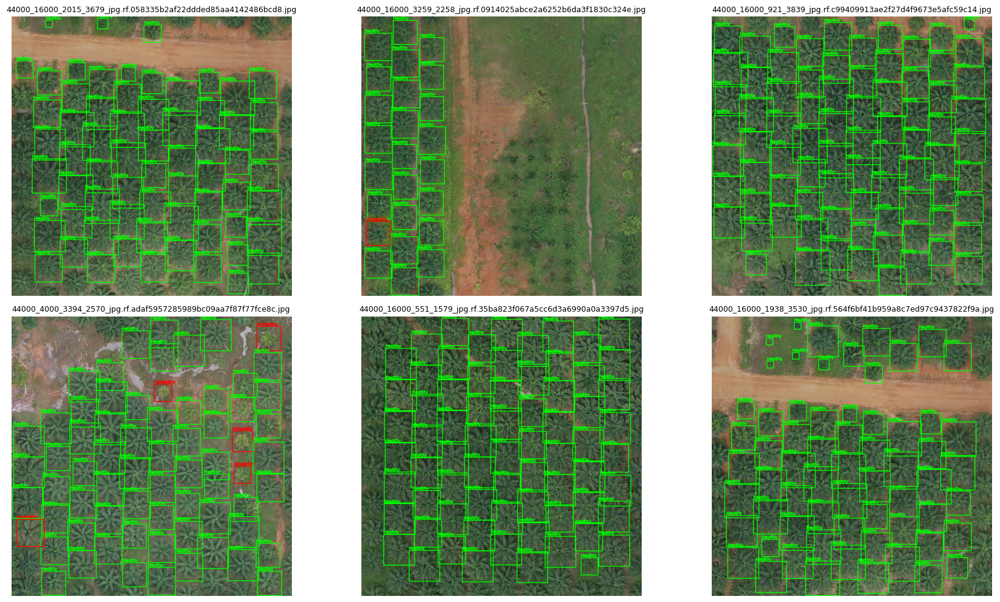

In [20]:
show_tree_samples(train_images_path, train_label_path)

## 🛠️ **Data Preprocessing**

To combine the train, validation, and test datasets into a single folder called combined for data cleaning

In [21]:
combined_images_path = os.path.join(data_dir, "combined", "images")
combined_labels_path = os.path.join(data_dir, "combined", "labels")

os.makedirs(combined_images_path, exist_ok=True)
os.makedirs(combined_labels_path, exist_ok=True)

In [22]:
datasets = [
    (train_images_path, train_label_path),
    (valid_images_path, valid_label_path),
    (test_images_path, test_label_path)
]

In [23]:
for images_path, labels_path in datasets:
  for img in os.listdir(images_path):
    img_name, img_ext = os.path.splitext(img)
    label_file = img_name + ".txt"

    src_img = os.path.join(images_path, img)
    src_label = os.path.join(labels_path, label_file)

    # Copy image
    shutil.copy(src_img, os.path.join(combined_images_path, img))

    # Copy label if exists
    if os.path.exists(src_label):
      shutil.copy(src_label, os.path.join(combined_labels_path, label_file))

    else:
      print(f"Missing label for {img}")

To visualize the bounding box pixel size distribution to determine the cutoff between small and large trees

In [24]:
bbox_widths = []
bbox_heights = []
bbox_areas = []

for label_file in os.listdir(combined_labels_path):
    if not label_file.endswith(".txt"):
        continue

    label_path = os.path.join(combined_labels_path, label_file)
    base_name = os.path.splitext(label_file)[0]

    image_path = None
    for ext in [".jpg", ".png", ".jpeg"]:
      candidate = os.path.join(combined_images_path, base_name + ext)

      if os.path.exists(candidate):
        image_path = candidate
        break

    if image_path is None:
      continue # skip if image not found

    image = cv2.imread(image_path)
    if image is None:
      continue

    h, w, _ = image.shape

    with open(label_path, "r") as f:
      lines = f.readlines()

    for line in lines:
      parts = line.split()
      xc, yc, bw, bh = map(float, parts[1:])

      bw_px = bw * w
      bh_px = bh * h

      bbox_widths.append(bw_px)
      bbox_heights.append(bh_px)
      bbox_areas.append(bw_px * bh_px)



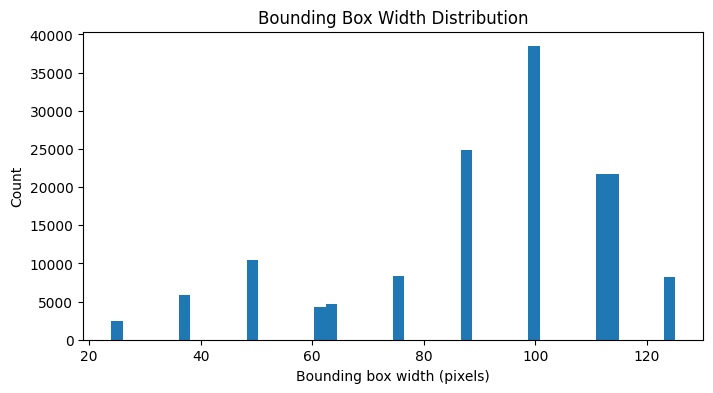

In [25]:
# Bounding Box Width Distribution
plt.figure(figsize=(8, 4))
plt.hist(bbox_widths, bins=50)
plt.xlabel("Bounding box width (pixels)")
plt.ylabel("Count")
plt.title("Bounding Box Width Distribution")
plt.show()

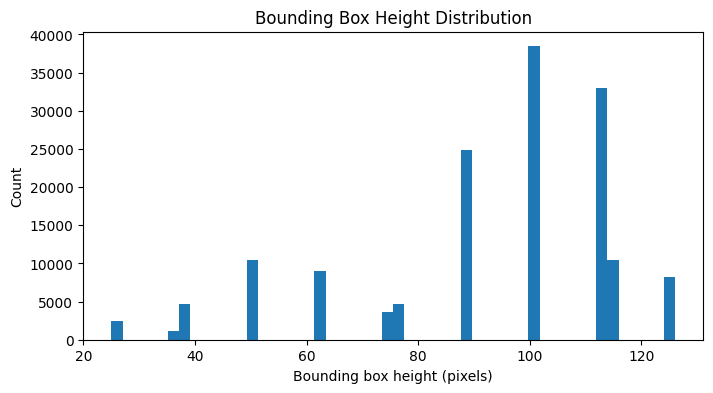

In [26]:
# Bounding Box Height Distribution
plt.figure(figsize=(8, 4))
plt.hist(bbox_heights, bins=50)
plt.xlabel("Bounding box height (pixels)")
plt.ylabel("Count")
plt.title("Bounding Box Height Distribution")
plt.show()

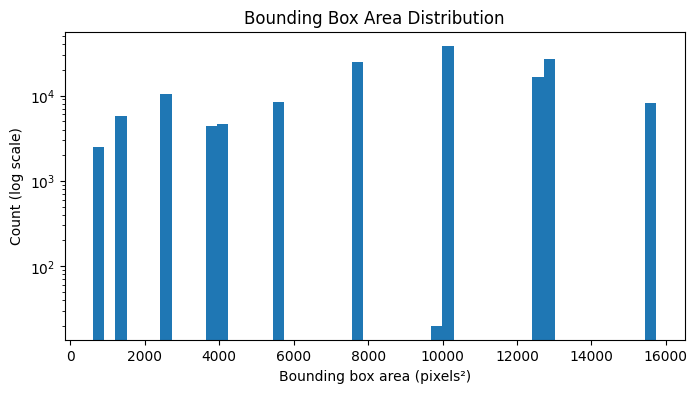

In [27]:
# Bouding Box Area Distribution
plt.figure(figsize=(8, 4))
plt.hist(bbox_areas, bins=50)
plt.yscale("log")
plt.xlabel("Bounding box area (pixels²)")
plt.ylabel("Count (log scale)")
plt.title("Bounding Box Area Distribution")
plt.show()

In [28]:
def print_bounding_box_stats(name, data):
    print(f"{name}")
    print(f"  Min: {np.min(data):.1f}")
    print(f"  25%: {np.percentile(data, 25):.1f}")
    print(f"  Median: {np.median(data):.1f}")
    print(f"  75%: {np.percentile(data, 75):.1f}")
    print(f"  Max: {np.max(data):.1f}")
    print()

print_bounding_box_stats("Bounding Box Width (px)", bbox_widths)
print_bounding_box_stats("Bounding BoxHeight (px)", bbox_heights)
print_bounding_box_stats("Bounding Box Area (px²)", bbox_areas)

Bounding Box Width (px)
  Min: 24.0
  25%: 87.0
  Median: 100.0
  75%: 112.0
  Max: 125.0

Bounding BoxHeight (px)
  Min: 25.0
  25%: 88.0
  Median: 101.0
  75%: 113.0
  Max: 126.0

Bounding Box Area (px²)
  Min: 600.0
  25%: 7656.0
  Median: 10100.0
  75%: 12656.0
  Max: 15750.0



Based on the bounding box distribution graphs and statistical analysis, a threshold of bounding box pixels = 60 was selected to remove small trees

In [29]:
MIN_BBOX_PIXELS = 60

removed_boxes = 0
kept_boxes = 0
images_removed = 0

for label_file in os.listdir(combined_labels_path):
  if not label_file.endswith(".txt"):
    continue

  label_path = os.path.join(combined_labels_path, label_file)
  base_name = os.path.splitext(label_file)[0]

  # Find corresponding image
  image_path = None
  for image_exts in [".jpg", ".png", ".jpeg"]:
    candidate = os.path.join(combined_images_path, base_name + image_exts)

    if os.path.exists(candidate):
      image_path = candidate
      break

  if image_path is None:
    continue # skip if image missing

  image = cv2.imread(image_path)
  if image is None:
    continue

  h, w, _ = image.shape

  with open(label_path, "r") as f:
    lines = f.readlines()

  new_lines = []

  for line in lines:
    parts = line.split()
    cls = int(parts[0])
    xc, yc, bw, bh = map(float, parts[1:])

    bbox_w_px = bw * w
    bbox_h_px = bh * h

    if bbox_w_px >= MIN_BBOX_PIXELS and bbox_h_px >= MIN_BBOX_PIXELS:
      new_lines.append(line)
      kept_boxes += 1

    else:
      removed_boxes += 1

  if new_lines:
    with open(label_path, "w") as f:
      f.writelines(new_lines)

  else:
    os.remove(label_path)
    os.remove(image_path)
    images_removed += 1

print("Cleaning Summary: ")
print("Kept boxes: ", kept_boxes)
print("Removed small boxes: ", removed_boxes)
print("Image removed (no boxes left): ", images_removed)

Cleaning Summary: 
Kept boxes:  132350
Removed small boxes:  18710
Image removed (no boxes left):  0


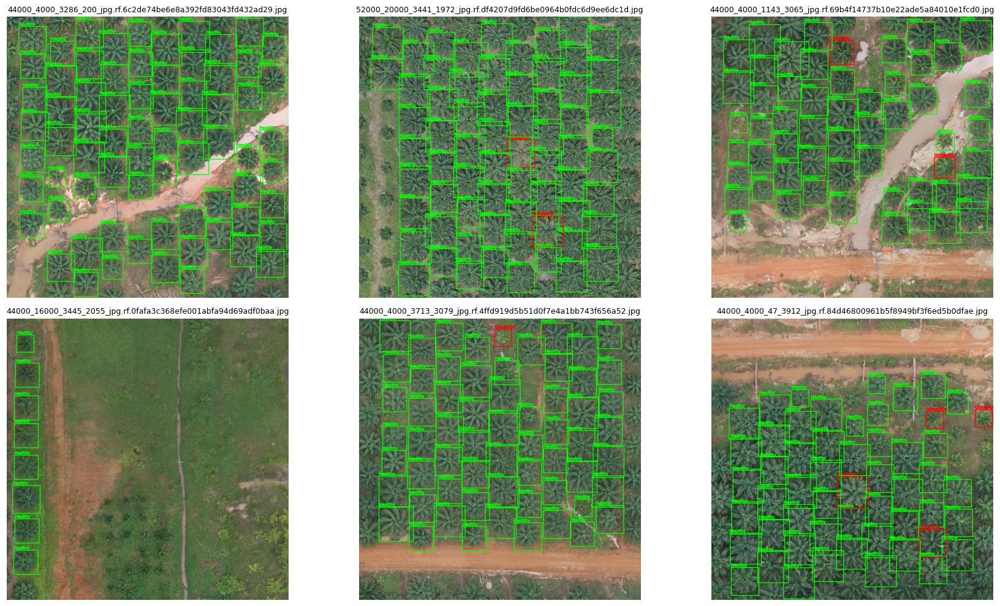

In [30]:
show_tree_samples(combined_images_path, combined_labels_path)

In [ ]:
healthy_count = 0
unhealthy_count = 0

# Loop through all annotation files
for label_file in os.listdir(combined_labels_path):

  if label_file.endswith(".txt"):
    with open(os.path.join(combined_labels_path, label_file), "r") as f:

      for line in f.readlines():
        class_id = int(line.split()[0])

        if class_id == 0:
          healthy_count += 1

        elif class_id == 1:
          unhealthy_count += 1

print("Healthy oil palm trees: ", healthy_count)
print("Unhealthy oil palm trees: ", unhealthy_count)

Healthy oil palm trees:  130332
Unhealthy oil palm trees:  2018


In [ ]:
clean_data_dir = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2_new")

os.makedirs(clean_data_dir, exist_ok=True)

splits = ["new_train", "new_valid", "new_test"]

for split in splits:
    os.makedirs(os.path.join(clean_data_dir, split, "images"), exist_ok=True)
    os.makedirs(os.path.join(clean_data_dir, split, "labels"), exist_ok=True) 

files_to_copy = [
    "data.yaml",
    "README.dataset.txt",
    "README.roboflow.txt"
]

raw_data_dir = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2")

for filename in files_to_copy:
    src = os.path.join(raw_data_dir, filename)
    dst = os.path.join(clean_data_dir, filename)

    if os.path.exists(src):
        shutil.copy(src, dst)

    else:
        print(f"[WARNING] {filename} not found. Skipping...")

print("Cleaned dataset prepared successfully.")

In [ ]:
# Update data.yaml in cleaned dataset
import yaml
clean_data_yaml_path = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2_new", "data.yaml")

with open(clean_data_yaml_path, "r") as f:
    data = yaml.safe_load(f)

# Update paths dynamically
data["train"] = "../new_train/images"
data["val"] = "../new_valid/images"
data["test"] = "../new_test/images"

with open(clean_data_yaml_path, "w") as f:
    yaml.safe_dump(data, f, sort_keys=False)

print("data.yaml updated successfully.")

data.yaml updated successfully.


In [36]:
samples = []

for label_file in os.listdir(combined_labels_path):
  if not label_file.endswith(".txt"):
    continue

  name = os.path.splitext(label_file)[0]

  for image_exts in [".jpg", ".png", ".jpeg"]:
    img_path = os.path.join(combined_images_path, name + image_exts)
    if os.path.exists(img_path):
      samples.append((name, ext))
      break

In [ ]:
# Split new dataset to 70% train, 20% valid, and 10% test
random.seed(42)
random.shuffle(samples)

n = len(samples)
n_train = int(0.7 * n)
n_valid = int(0.2 * n)

train_samples = samples[:n_train]
valid_samples = samples[n_train:n_train + n_valid]
test_samples  = samples[n_train + n_valid:]

In [38]:
def copy_samples(sample_list, split):
    for name, image_ext in sample_list:
        shutil.copy(
            os.path.join(combined_images_path, name + image_ext),
            os.path.join(clean_data_dir, split, "images", name + image_ext)
        )
        shutil.copy(
            os.path.join(combined_labels_path, name + ".txt"),
            os.path.join(clean_data_dir, split, "labels", name + ".txt")
        )

copy_samples(train_samples, "new_train")
copy_samples(valid_samples, "new_valid")
copy_samples(test_samples, "new_test")

In [39]:
def count_boxes(labels_path):
    healthy = unhealthy = 0
    for lf in os.listdir(labels_path):
        if not lf.endswith(".txt"):
            continue
        with open(os.path.join(labels_path, lf)) as f:
            for line in f:
                cls = int(line.split()[0])
                if cls == 0:
                    healthy += 1
                else:
                    unhealthy += 1
    return healthy, unhealthy

for split in ["new_train", "new_valid", "new_test"]:
    h, u = count_boxes(os.path.join(clean_data_dir, split, "labels"))
    print(f"{split}: Healthy={h}, Unhealthy={u}, Ratio={h/u:.1f}")

new_train: Healthy=90840, Unhealthy=1455, Ratio=62.4
new_valid: Healthy=26327, Unhealthy=389, Ratio=67.7
new_test: Healthy=13165, Unhealthy=174, Ratio=75.7


In [ ]:
clean_data_dir = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2_new")

# New Train
new_train_path = os.path.join(clean_data_dir, "new_train")
new_train_images_path = os.path.join(new_train_path, "images")
new_train_label_path = os.path.join(new_train_path, "labels")

# New Valid
new_valid_path = os.path.join(clean_data_dir, "new_valid")
new_valid_images_path = os.path.join(new_valid_path, "images")
new_valid_label_path = os.path.join(new_valid_path, "labels")

# New Test
new_test_path = os.path.join(clean_data_dir, "new_test")
new_test_images_path = os.path.join(new_test_path, "images")
new_test_label_path = os.path.join(new_test_path, "labels")


In [41]:
# Check Data Leakage (before training)
def list_images(images_dir):
    image_exts = (".jpg", ".jpeg", ".png")
    return set([f for f in os.listdir(images_dir) if f.lower().endswith(image_exts)])

train_files = list_images(new_train_images_path)
valid_files = list_images(new_valid_images_path)
test_files  = list_images(new_test_images_path)

print("Train ∩ Valid:", len(train_files & valid_files))
print("Train ∩ Test:", len(train_files & test_files))
print("Valid ∩ Test:", len(valid_files & test_files))

# If all are 0 -> good (no leakage)

Train ∩ Valid: 0
Train ∩ Test: 0
Valid ∩ Test: 0


In [ ]:
# Zip new_train, new_valid, new_test, and data.yaml into a single file for future use
# !cd ../data && zip -r Oil-Palm-Health-Detection-2_new.zip \
#     Oil-Palm-Health-Detection-2_new/new_train \
#     Oil-Palm-Health-Detection-2_new/new_valid \
#     Oil-Palm-Health-Detection-2_new/new_test \
#     Oil-Palm-Health-Detection-2_new/data.yaml \
#     Oil-Palm-Health-Detection-2_new/README.dataset.txt \
#     Oil-Palm-Health-Detection-2_new/README.roboflow.txt

  adding: Oil-Palm-Health-Detection-2_new/new_train/ (stored 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/ (stored 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/52000_20000_59_1477_jpg.rf.c53868eca8e85b32f604162e692f47b1.jpg (deflated 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/44000_4000_1103_1583_jpg.rf.d4897fe7b9b33b8a2a4608ade5aa6927.jpg (deflated 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/52000_20000_1925_2970_jpg.rf.8201fff7340c6f5ff0a828c959b031b0.jpg (deflated 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/44000_16000_173_2790_jpg.rf.e00a43d9d2266dc8d5c0501f00e039ab.jpg (deflated 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/44000_4000_2101_1027_jpg.rf.78b8a20f957ecddc59fec0ee313f499a.jpg (deflated 0%)
  adding: Oil-Palm-Health-Detection-2_new/new_train/images/52000_20000_2754_2903_jpg.rf.66f2b43e0c827b9957afe0563be0adb7.jpg (deflated 0%)
  adding: Oil-Palm-Health-Detectio

## ⚙️ **Model Training**

### **Region-based Convolutional Neural Network (R-CNN)**

Data Augmentation

The dataset is highly imbalanced. Imbalance is addressed by:

1. Increasing the exposure of Unhealthy samples through training-time data augmentation, allowing the model to encounter diverse variants of unhealthy trees more frequently.

2. Applying simple data augmentation (horizontal flipping and brightness variation) to the training set only

In [ ]:
# Find which training images contain Unhealthy trees
def has_unhealthy(label_file_path):
    if not os.path.exists(label_file_path):
        return False
    with open(label_file_path, "r") as f:
        for line in f:
            cls = int(line.strip().split()[0])
            if cls == 1:  # YOLO: 1 = Unhealthy
                return True
    return False

In [49]:
# Build weights per training image
train_img_files = sorted([f for f in os.listdir(new_train_images_path) if f.lower().endswith((".jpg",".jpeg",".png"))])

weights = []
for img_name in train_img_files:
    label_name = os.path.splitext(img_name)[0] + ".txt"
    label_path = os.path.join(new_train_label_path, label_name)

    # overweight unhealthy images (tune these numbers if needed)
    w = 8.0 if has_unhealthy(label_path) else 1.0
    weights.append(w)

print("Example weights:", weights[:10])

Example weights: [1.0, 1.0, 8.0, 1.0, 1.0, 1.0, 1.0, 8.0, 1.0, 1.0]


In [ ]:
# Use WeightedRandomSampler to oversample unhealthy tree images during training
sampler = WeightedRandomSampler(
    weights=torch.DoubleTensor(weights),
    num_samples=len(weights),   # one epoch = same length as dataset
    replacement=True
)

Add simple augmentations on training data.
*   Horizontal flip (update boxes)
*  Adjust brightness (doesn't change boxes)



In [51]:
class SimpleDetAugment:
    def __init__(self, p_flip=0.5, brightness=0.15):
        self.p_flip = p_flip
        self.brightness = brightness

    def __call__(self, img, target):
        # img is a Tensor [C,H,W]
        _, h, w = img.shape

        # Random horizontal flip
        if random.random() < self.p_flip and target["boxes"].numel() > 0:
            img = F.hflip(img)
            boxes = target["boxes"].clone()
            # boxes: [xmin, ymin, xmax, ymax]
            boxes[:, [0, 2]] = w - boxes[:, [2, 0]]
            target["boxes"] = boxes

        # Random brightness (does not affect boxes)
        if self.brightness > 0:
            factor = 1.0 + random.uniform(-self.brightness, self.brightness)
            img = torch.clamp(img * factor, 0, 1)

        return img, target

In [52]:
train_det_aug = SimpleDetAugment(
    p_flip=0.5,
    brightness=0.15
)

In [53]:
class OilPalmRCNNDataset(Dataset):
    """
    Reads:
      - images from .../images
      - YOLO labels from .../labels (class xc yc w h, normalized)

    Returns:
      image: Tensor[C,H,W]
      target: dict with:
        boxes: FloatTensor[N,4] in pixel coords (xmin, ymin, xmax, ymax)
        labels: Int64Tensor[N] (1 = Healthy, 2 = Unhealthy, 0 = background)
    """
    def __init__(self, images_dir, labels_dir, det_transform=None):
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        self.det_transform = det_transform

        image_exts = (".jpg", ".jpeg", ".png")
        self.image_files = sorted([f for f in os.listdir(images_dir) if f.lower().endswith(image_exts)])

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_name = self.image_files[idx]
        img_path = os.path.join(self.images_dir, img_name)

        img = Image.open(img_path).convert("RGB")
        w, h = img.size

        label_file = os.path.splitext(img_name)[0] + ".txt"
        label_path = os.path.join(self.labels_dir, label_file)

        boxes = []
        labels = []

        if os.path.exists(label_path):
            with open(label_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) != 5:
                        continue

                    cls = int(parts[0])
                    xc, yc, bw, bh = map(float, parts[1:])

                    # YOLO normalized -> pixel xyxy
                    xmin = (xc - bw / 2) * w
                    ymin = (yc - bh / 2) * h
                    xmax = (xc + bw / 2) * w
                    ymax = (yc + bh / 2) * h

                    # filter invalid
                    if xmax <= xmin or ymax <= ymin:
                        continue

                    boxes.append([xmin, ymin, xmax, ymax])

                    # Remap classes for Faster R-CNN:
                    # YOLO: 0=Healthy, 1=Unhealthy
                    # R-CNN: 0=background, 1=Healthy, 2=Unhealthy
                    labels.append(1 if cls == 0 else 2)

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        # Faster R-CNN expects a target dict even if no objects
        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([idx], dtype=torch.int64)
        }

        img = T.ToTensor()(img)
        if self.det_transform:
          img, target = self.det_transform(img, target)

        return img, target

In [ ]:
# Split back the data
def collate_fn(batch):
    return tuple(zip(*batch))

train_ds = OilPalmRCNNDataset(
    images_dir=new_train_images_path,
    labels_dir=new_train_label_path,
    det_transform=train_det_aug
)

valid_ds = OilPalmRCNNDataset(
    images_dir=new_valid_images_path,
    labels_dir=new_valid_label_path,
    det_transform=None             # NO augmentation
)

test_ds = OilPalmRCNNDataset(
    images_dir=new_test_images_path,
    labels_dir=new_test_label_path,
    det_transform=None             # NO augmentation
)

print("Train images:", len(train_ds),
      "Valid images:", len(valid_ds),
      "Test images:", len(test_ds))

Train images: 1612 Valid images: 460 Test images: 231


In [55]:
def summarize_sampling(weights, dataset):
    weights = np.array(weights, dtype=float)

    healthy_imgs = 0
    unhealthy_imgs = 0
    healthy_weights = []
    unhealthy_weights = []

    for w, (_, target) in zip(weights, dataset):
        if (target["labels"] == 2).any():  # 2 = Unhealthy
            unhealthy_imgs += 1
            unhealthy_weights.append(w)
        else:
            healthy_imgs += 1
            healthy_weights.append(w)

    avg_healthy_w = np.mean(healthy_weights)
    avg_unhealthy_w = np.mean(unhealthy_weights)

    expected_unhealthy_ratio = (
        unhealthy_imgs * avg_unhealthy_w
    ) / (
        unhealthy_imgs * avg_unhealthy_w + healthy_imgs * avg_healthy_w
    )

    print("=== Sampling Summary ===")
    print(f"Healthy images:   {healthy_imgs}")
    print(f"Unhealthy images: {unhealthy_imgs}")
    print(f"Weight ratio (Unhealthy : Healthy) = {avg_unhealthy_w:.1f} : {avg_healthy_w:.1f}")
    print(f"Expected unhealthy samples per epoch ≈ {expected_unhealthy_ratio*100:.2f}%")

In [ ]:
summarize_sampling(weights, train_ds)

=== Sampling Summary ===
Healthy images:   799
Unhealthy images: 813
Weight ratio (Unhealthy : Healthy) = 8.0 : 1.0
Expected unhealthy samples per epoch ≈ 89.06%


In [ ]:
# Dataloader
train_loader = DataLoader(
    train_ds,
    batch_size=2,
    sampler=sampler,          # oversampling
    num_workers=2,
    collate_fn=collate_fn
)

valid_loader = DataLoader(
    valid_ds,
    batch_size=2,
    shuffle=False,
    num_workers=2,
    collate_fn=collate_fn
)

test_loader = DataLoader(
    test_ds,
    batch_size=2,
    shuffle=False,
    num_workers=2,
    collate_fn=collate_fn
)

In [ ]:
num_classes = 3  # 0 = background, 1 = Healthy, 2 = Unhealthy

rcnn_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")
in_features = rcnn_model.roi_heads.box_predictor.cls_score.in_features
rcnn_model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
rcnn_model = rcnn_model.to(device)
device

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


100%|██████████| 160M/160M [00:00<00:00, 189MB/s]


device(type='cuda')

In [ ]:
# Optimizer (standard for Faster R-CNN fine-tuning)
params = [p for p in rcnn_model.parameters() if p.requires_grad]
optimizer = optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# (Optional) Scheduler: slowly reduces learning rate
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

During one training epoch, the model:

1. Receives batches of images along with their ground truth annotations.

2. Performs a forward pass to generate predictions.

3. Compares the predictions against the ground truth.

4. Computes loss values that quantify prediction errors.

5. Updates model parameters via backpropagation to improve future predictions.

In [ ]:
def train_one_epoch(model, loader, optimizer, device):

    model.train()
    running = 0.0

    for images, targets in loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running += loss.item()

    return running / max(len(loader), 1)

In [ ]:
# Evaluation metrics (mAP)
from torchmetrics.detection.mean_ap import MeanAveragePrecision

@torch.no_grad()
def evaluate_map(model, loader, device):
    model.eval()
    metric = MeanAveragePrecision(box_format="xyxy", iou_type="bbox", class_metrics=True)

    for images, targets in loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        preds = model(images)
        metric.update(preds, targets)

    return metric.compute()

In [ ]:
# Faster R-CNN Model Training
import copy

model_dir = os.path.join(base_dir, "model")
RCNN_MODEL_PATH = os.path.join(model_dir, "faster_rcnn_10_epochs.pth")

max_epochs = 10
patience = 2   # stop if val mAP@0.5 doesn't improve for 2 epochs

best_map50 = -1.0
best_state = None
no_improve = 0

for epoch in range(max_epochs):
    train_loss = train_one_epoch(rcnn_model, train_loader, optimizer, device)

    # evaluate on validation set
    val_metrics = evaluate_map(rcnn_model, valid_loader, device)
    val_map50 = float(val_metrics["map_50"])

    print(f"Epoch {epoch+1}/{max_epochs} | train_loss={train_loss:.4f} | val_mAP@0.5={val_map50:.4f}")

    # Early stopping check
    if val_map50 > best_map50 + 1e-4:
        best_map50 = val_map50
        best_state = copy.deepcopy(rcnn_model.state_dict())
        no_improve = 0
        print("✅ New best model saved")

    else:
        no_improve += 1
        print(f"⚠ No improvement ({no_improve}/{patience})")

    # Update scheduler (optional)
    scheduler.step()

    if no_improve >= patience:
        print("🛑 Early stopping triggered")
        break

# Load best model weights
if best_state is not None:
    rcnn_model.load_state_dict(best_state)
    print(f"✅ Loaded best model with val mAP@0.5 = {best_map50:.4f}")

    torch.save(rcnn_model.state_dict(), RCNN_MODEL_PATH)
    print("✅ Model saved to", RCNN_MODEL_PATH)

else:
    print("⚠️ No best model to save")

Epoch 1/10 | train_loss=0.4362 | val_mAP@0.5=0.5680
  ✅ New best model saved
Epoch 2/10 | train_loss=0.3427 | val_mAP@0.5=0.6799
  ✅ New best model saved
Epoch 3/10 | train_loss=0.3022 | val_mAP@0.5=0.8317
  ✅ New best model saved
Epoch 4/10 | train_loss=0.2634 | val_mAP@0.5=0.9235
  ✅ New best model saved
Epoch 5/10 | train_loss=0.2406 | val_mAP@0.5=0.9478
  ✅ New best model saved
Epoch 6/10 | train_loss=0.1928 | val_mAP@0.5=0.9609
  ✅ New best model saved
Epoch 7/10 | train_loss=0.1776 | val_mAP@0.5=0.9597
  ⚠ No improvement (1/2)
Epoch 8/10 | train_loss=0.1708 | val_mAP@0.5=0.9620
  ✅ New best model saved
Epoch 9/10 | train_loss=0.1632 | val_mAP@0.5=0.9636
  ✅ New best model saved
Epoch 10/10 | train_loss=0.1581 | val_mAP@0.5=0.9561
  ⚠ No improvement (1/2)
✅ Loaded best model with val mAP@0.5 = 0.9636
✅ Model saved to /content/faster_rcnn_best.pth


### **YOLO11**

In [ ]:
from ultralytics import YOLO

clean_data_yaml_path = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection-2_new", "data.yaml")

# There are 5 YOLO model variants n (nano), s (small), m (medium), l (large), and x (extra large)
# For the purpose of the analysis, n (nano) variant was selected

yolo_model = YOLO("yolo11n.pt")

yolo_model.train(
    data=clean_data_yaml_path,
    imgsz=640,
    epochs=10,
    batch=8,
    device=0,
    momentum=0.9,
    patience=2,
    cls=1.5,
    optimizer="SGD",

    # Data Augmentation
    degrees=20.0,
    fliplr=0.5,

    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4
)

Ultralytics 8.3.241 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=1.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Oil-Palm-Health-Detection-2/data.yaml, degrees=20.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.9, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=3, perspective=0.0, plots=

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7e28b6ece030>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

## ✅ **Model Evaluation**

### **Region-based Convolutional Neural Network (R-CNN)**

In [57]:
num_classes = 3  # 0 = background, 1 = Healthy, 2 = Unhealthy

rcnn_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")
in_features = rcnn_model.roi_heads.box_predictor.cls_score.in_features
rcnn_model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
rcnn_model = rcnn_model.to(device)
device

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /Users/nqb/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


100%|██████████| 160M/160M [00:03<00:00, 42.2MB/s] 


device(type='cpu')

In [ ]:
# Reload saved model
model_dir = os.path.join(base_dir, "model")
RCNN_MODEL_PATH = os.path.join(model_dir, "faster_rcnn_10_epochs.pth")

rcnn_model.load_state_dict(torch.load(RCNN_MODEL_PATH, map_location=device))
rcnn_model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
import time
from torchvision.ops import box_iou

@torch.no_grad()
def compute_rcnn_confusion_matrix(model, loader, device,
                                  class_ids=[1, 2], score_thresh=0.7, iou_thresh=0.3):
    model.eval()

    # Confusion matrix: rows = GT, cols = Pred
    cm = torch.zeros((len(class_ids), len(class_ids)), dtype=torch.int64)
    class_to_idx = {cid: i for i, cid in enumerate(class_ids)}

    total_images = 0
    start_time = time.perf_counter()
    inference_time = 0.0

    for images, targets in loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        batch_size = len(images)
        total_images += batch_size

        # Inference timing
        inf_start = time.perf_counter()
        preds = model(images)
        inf_end = time.perf_counter()

        inference_time += (inf_end - inf_start)

        # Matching & confusion matrix 
        for pred, tgt in zip(preds, targets):
            gt_boxes = tgt["boxes"]
            gt_labels = tgt["labels"]

            keep = pred["scores"] >= score_thresh
            pred_boxes = pred["boxes"][keep]
            pred_labels = pred["labels"][keep]

            if gt_boxes.numel() == 0 or pred_boxes.numel() == 0:
                continue

            ious = box_iou(pred_boxes, gt_boxes)
            matched_gt = set()
            matched_pred = set()

            pairs = torch.nonzero(ious >= iou_thresh, as_tuple=False)
            if pairs.numel() == 0:
                continue

            pair_ious = ious[pairs[:, 0], pairs[:, 1]]
            order = torch.argsort(pair_ious, descending=True)
            pairs = pairs[order]

            for p_idx, g_idx in pairs.tolist():
                if p_idx in matched_pred or g_idx in matched_gt:
                    continue

                matched_pred.add(p_idx)
                matched_gt.add(g_idx)

                true_cls = gt_labels[g_idx].item()
                pred_cls = pred_labels[p_idx].item()

                if true_cls in class_to_idx and pred_cls in class_to_idx:
                    cm[class_to_idx[true_cls], class_to_idx[pred_cls]] += 1

    end_time = time.perf_counter()

    total_time = end_time - start_time

    timing_stats = {
        "RCNN Inference Time (predict)": round(total_time, 4),
    }

    cm = pd.DataFrame(
        cm.numpy(),
        index=["GT Healthy", "GT Unhealthy"],
        columns=["Pred Healthy", "Pred Unhealthy"]
    )

    return cm, timing_stats

In [ ]:
cm_rcnn, timing = compute_rcnn_confusion_matrix(rcnn_model, test_loader, device,
                                                score_thresh=0.7, iou_thresh=0.3)

for k, v in timing.items():
    print(f"{k}: {v}")

RCNN Inference Time (predict):: 23.0285


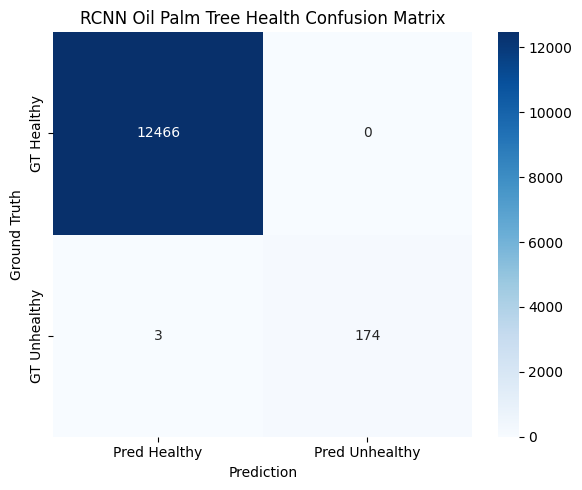

In [ ]:
# Plot confusion matrix (predict)
plt.figure(figsize=(6,5))
sns.heatmap(cm_rcnn, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Prediction")
plt.ylabel("Ground Truth")
plt.title("RCNN Oil Palm Tree Health Confusion Matrix")
plt.tight_layout()
plt.show()

In [ ]:
def _match_preds_to_gts(gt_boxes, pred_boxes, iou_thresh=0.3):
    """
    Greedy matching between GT and predictions using IoU.
    Returns number of matches (TP).
    """
    if gt_boxes.numel() == 0 or pred_boxes.numel() == 0:
        return 0

    ious = box_iou(pred_boxes, gt_boxes)  # [num_pred, num_gt]
    tp = 0

    matched_gts = set()

    # Sort all pairs by IoU descending
    pairs = torch.nonzero(ious >= iou_thresh, as_tuple=False)
    if pairs.numel() == 0:
        return 0

    pair_ious = ious[pairs[:, 0], pairs[:, 1]]
    order = torch.argsort(pair_ious, descending=True)
    pairs = pairs[order]

    used_preds = set()
    for p_idx, g_idx in pairs.tolist():
        if p_idx in used_preds or g_idx in matched_gts:
            continue
        used_preds.add(p_idx)
        matched_gts.add(g_idx)
        tp += 1

    return tp

@torch.no_grad()
def evaluate_per_class_detection(model, loader, device,
                                 class_map={1: "Healthy", 2: "Unhealthy"},
                                 score_thresh=0.7, iou_thresh=0.3):
    """
    Computes per-class TP/FP/FN + Precision/Recall/F1 using IoU matching.
    """
    model.eval()
    results = {cid: {"TP": 0, "FP": 0, "FN": 0} for cid in class_map.keys()}

    for images, targets in loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        preds = model(images)

        for pred, tgt in zip(preds, targets):
            gt_boxes_all = tgt["boxes"]
            gt_labels_all = tgt["labels"]

            pred_boxes_all = pred["boxes"]
            pred_labels_all = pred["labels"]
            pred_scores_all = pred["scores"]

            # apply score threshold
            keep = pred_scores_all >= score_thresh
            pred_boxes_all = pred_boxes_all[keep]
            pred_labels_all = pred_labels_all[keep]

            for cid in class_map.keys():
                gt_mask = gt_labels_all == cid
                pred_mask = pred_labels_all == cid

                gt_boxes = gt_boxes_all[gt_mask]
                pred_boxes = pred_boxes_all[pred_mask]

                tp = _match_preds_to_gts(gt_boxes, pred_boxes, iou_thresh=iou_thresh)
                fp = int(pred_boxes.shape[0] - tp)
                fn = int(gt_boxes.shape[0] - tp)

                results[cid]["TP"] += tp
                results[cid]["FP"] += fp
                results[cid]["FN"] += fn

    # Impute metrics
    final = {}
    for cid, counts in results.items():
        TP, FP, FN = counts["TP"], counts["FP"], counts["FN"]
        precision = TP / (TP + FP + 1e-9)
        recall = TP / (TP + FN + 1e-9)
        f1 = 2 * precision * recall / (precision + recall + 1e-9)

        final[class_map[cid]] = {
            "TP": TP, "FP": FP, "FN": FN,
            "Precision": float(precision),
            "Recall": float(recall),
            "F1": float(f1),
            "score_thresh": score_thresh,
            "iou_thresh": iou_thresh
        }
    return final

def evaluate_both_classes(model, test_loader, device, score_thresh=0.7, iou_thresh=0.3):
    return evaluate_per_class_detection(
        model, test_loader, device,
        class_map={1: "Healthy", 2: "Unhealthy"},
        score_thresh=score_thresh,
        iou_thresh=iou_thresh
    )

In [ ]:
@torch.no_grad()
def compute_map50_single_class(model, loader, device,
                               class_id, iou_thresh=0.3):
    model.eval()

    all_scores = []
    all_matches = []
    total_gt = 0

    for images, targets in loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        preds = model(images)

        for pred, tgt in zip(preds, targets):
            gt_mask = tgt["labels"] == class_id
            gt_boxes = tgt["boxes"][gt_mask]
            total_gt += gt_boxes.shape[0]

            pred_mask = pred["labels"] == class_id
            pred_boxes = pred["boxes"][pred_mask]
            pred_scores = pred["scores"][pred_mask]

            if pred_boxes.numel() == 0:
                continue

            if gt_boxes.numel() == 0:
                for s in pred_scores:
                    all_scores.append(s.item())
                    all_matches.append(0)
                continue

            ious = box_iou(pred_boxes, gt_boxes)

            order = torch.argsort(pred_scores, descending=True)
            pred_boxes = pred_boxes[order]
            pred_scores = pred_scores[order]
            ious = ious[order]

            matched_gt = set()

            for i in range(pred_boxes.shape[0]):
                max_iou, gt_idx = ious[i].max(dim=0)
                if max_iou >= iou_thresh and gt_idx.item() not in matched_gt:
                    matched_gt.add(gt_idx.item())
                    all_matches.append(1)
                else:
                    all_matches.append(0)

                all_scores.append(pred_scores[i].item())

    if total_gt == 0:
        return 0.0

    order = np.argsort(-np.array(all_scores))
    matches = np.array(all_matches)[order]

    tp = np.cumsum(matches)
    fp = np.cumsum(1 - matches)

    recall = tp / (total_gt + 1e-9)
    precision = tp / (tp + fp + 1e-9)

    # VOC-style AP (11-point interpolation)
    ap = 0.0
    for t in np.linspace(0, 1, 11):
        p = precision[recall >= t].max() if np.any(recall >= t) else 0
        ap += p / 11

    return ap

In [ ]:
def compute_map50_rcnn(model, loader, device, class_map):
    ap_results = {}

    for cid, cname in class_map.items():
        ap = compute_map50_single_class(
            model, loader, device,
            class_id=cid,
            iou_thresh=0.5
        )
        ap_results[cname] = ap

    mAP50 = float(np.mean(list(ap_results.values())))

    return ap_results, mAP50

In [ ]:
def evaluate_both_classes_with_map(model, test_loader, device,
                                   score_thresh=0.7, iou_thresh=0.3):
    class_map = {1: "Healthy", 2: "Unhealthy"}

    # Existing metrics
    detection_metrics = evaluate_per_class_detection(
        model, test_loader, device,
        class_map=class_map,
        score_thresh=score_thresh,
        iou_thresh=iou_thresh
    )

    # mAP50
    ap_per_class, map50 = compute_map50_rcnn(
        model, test_loader, device,
        class_map=class_map
    )

    return detection_metrics, ap_per_class, map50

In [ ]:
metrics, ap_per_class, map50 = evaluate_both_classes_with_map(
    rcnn_model, test_loader, device,
    score_thresh=0.7,
    iou_thresh=0.3
)

print("Per-class detection metrics:")
for cls, stats in metrics.items():
    print(cls, stats)

print("\nAP@0.5 per class:")
for cls, ap in ap_per_class.items():
    print(f"{cls}: {ap:.4f}")

print(f"\nmAP@0.5: {map50:.4f}")

In [ ]:
both = evaluate_both_classes(rcnn_model, test_loader, device,
                             score_thresh=0.7, iou_thresh=0.3)
for cls, stats in both.items():
    print(cls, stats)

Healthy {'TP': 12466, 'FP': 120, 'FN': 98, 'Precision': 0.9904655966946615, 'Recall': 0.9921999363259318, 'F1': 0.9913320074522078, 'score_thresh': 0.7, 'iou_thresh': 0.3}
Unhealthy {'TP': 174, 'FP': 5, 'FN': 12, 'Precision': 0.9720670391007148, 'Recall': 0.9354838709627125, 'F1': 0.9534246570292061, 'score_thresh': 0.7, 'iou_thresh': 0.3}


In [ ]:
# Faster R-CNN Evaluation Metrics
def metrics_to_table(metrics_dict):
    rows = []
    for cls, stats in metrics_dict.items():
        rows.append({
            "Class": cls,
            "TP": stats["TP"],
            "FP": stats["FP"],
            "FN": stats["FN"],
            "Precision": round(stats["Precision"], 4),
            "Recall": round(stats["Recall"], 4),
            "F1-score": round(stats["F1"], 4),
            "IoU Threshold": stats["iou_thresh"],
            "Score Threshold": stats["score_thresh"]
        })
    return pd.DataFrame(rows)

oil_palm_health_metrics_df = metrics_to_table(both)
oil_palm_health_metrics_df

,Class,TP,FP,FN,Precision,Recall,F1-score,IoU Threshold,Score Threshold
0,Healthy,12466,120,98,0.9905,0.9922,0.9913,0.3,0.7
1,Unhealthy,174,5,12,0.9721,0.9355,0.9534,0.3,0.7


In [ ]:
# Helper functions
def _to_numpy_img(img_tensor):
    """
    Tensor [C,H,W] -> numpy [H,W,C] in range [0,1].
    """
    img = img_tensor.detach().cpu().permute(1, 2, 0).numpy()
    img = np.clip(img, 0, 1)
    return img

def _draw_boxes(ax, boxes, color="r", linewidth=2, labels=None):
    """
    Draw boxes (xmin, ymin, xmax, ymax).
    """
    for i, b in enumerate(boxes):
        x1, y1, x2, y2 = b
        rect = patches.Rectangle(
            (x1, y1), x2 - x1, y2 - y1,
            fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(rect)
        if labels is not None:
            ax.text(
                x1, max(0, y1 - 5),
                labels[i],
                fontsize=9,
                bbox=dict(facecolor="white", alpha=0.7, edgecolor="none")
            )

def _filter_class(target, class_id):
    """
    Return only boxes of a specific class_id from a target dict.
    """
    labels = target["labels"].detach().cpu()
    boxes  = target["boxes"].detach().cpu()
    mask = (labels == class_id)
    return boxes[mask].numpy()

def _filter_pred_class(pred, class_id, score_thresh=0.7):
    """
    Return pred boxes of class_id above score_thresh.
    """
    labels = pred["labels"].detach().cpu()
    boxes  = pred["boxes"].detach().cpu()
    scores = pred["scores"].detach().cpu()

    mask = (labels == class_id) & (scores >= score_thresh)
    boxes = boxes[mask]
    scores = scores[mask]

    # sort by score desc
    if boxes.numel() > 0:
        order = torch.argsort(scores, descending=True)
        boxes = boxes[order]
        scores = scores[order]

    return boxes.numpy(), scores.numpy()

In [ ]:
# Main Visualization
def display_predictions_RCNN(model, dataset, device,
                             class_id, class_name, score_thresh=0.7,
                             n_images=6, cols=3, show_gt=True,
                             show_pred=True, prefer_images_with_gt=True):
    """
    Shows a grid of images with boxes:
      - Ground Truth: Green
      - Predicted: Red
    """
    model.eval()
    rows = int(np.ceil(n_images / cols))
    fig, axes = plt.subplots(rows, cols, figsize=(cols*6, rows*6))
    axes = np.array(axes).reshape(-1)

    chosen = []

    # Choose images
    if prefer_images_with_gt:
        idx = []
        for i in range(len(dataset)):
            _, tgt = dataset[i]
            if (tgt["labels"] == class_id).any():
                idx.append(i)

        # Fallback if none
        if len(idx) == 0:
            idx = list(range(len(dataset)))

        # Pick first n_images or random
        chosen = idx[:n_images]

    else:
        chosen = list(range(min(n_images, len(dataset))))

    # Plot
    for ax_i, idx in enumerate(chosen):
        ax = axes[ax_i]
        img, tgt = dataset[idx]  # img: [C, H, W] in [0, 1]
        img_np = _to_numpy_img(img)
        ax.imshow(img_np)
        ax.axis("off")

        # Ground Truth (Green)
        if show_gt:
            gt = _filter_class(tgt, class_id)
            if len(gt) > 0:
                _draw_boxes(ax, gt, color="lime",
                            linewidth=2, labels=[f"GT {class_name}"] * len(gt))

        # Predicted (Red)
        if show_pred:
            with torch.no_grad():
                pred = model([img.to(device)])[0]

            pred_boxes, pred_scores = _filter_pred_class(pred, class_id,
                                                         score_thresh=score_thresh)

            if len(pred_boxes) > 0:
                _draw_boxes(ax, pred_boxes, color="red",
                            linewidth=2, labels=[f"Pred {class_name} ({s:.2f})" for s in pred_scores])

        ax.set_title(f"idx={idx} | {class_name} Trees | thresh={score_thresh}")

    # Blank remaining axes
    for j in range(len(chosen), len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

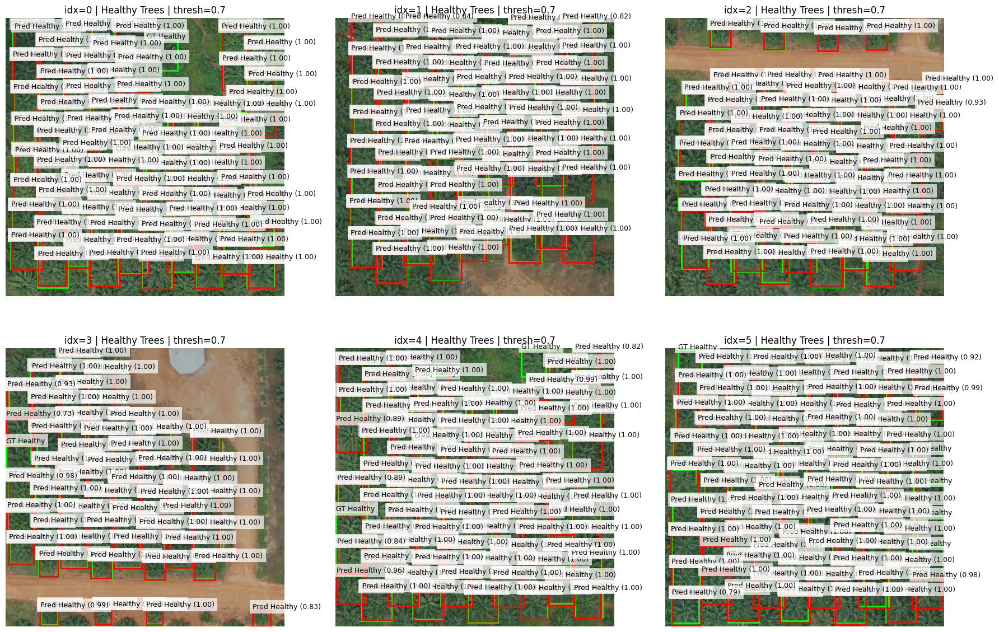

In [ ]:
# Healthy
display_predictions_RCNN(rcnn_model, test_ds, device,
                         class_id=1, class_name="Healthy", score_thresh=0.7,
                         n_images=6, cols=3, show_gt=True, show_pred=True,
                         prefer_images_with_gt=True)

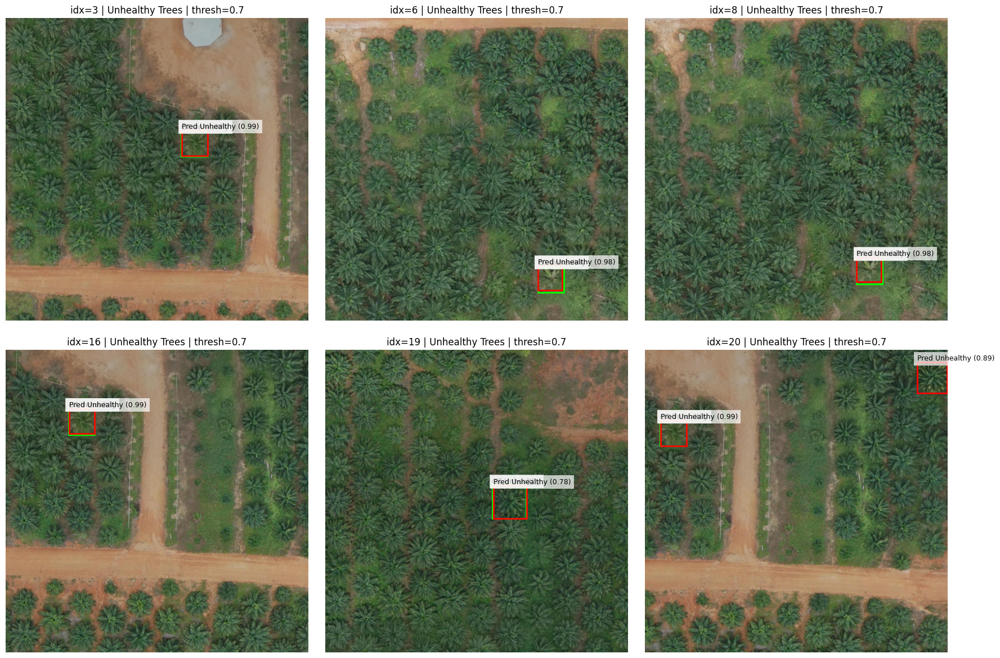

In [ ]:
# Unhealthy
display_predictions_RCNN(rcnn_model, test_ds, device,
                         class_id=2, class_name="Unhealthy", score_thresh=0.7,
                         n_images=6, cols=3, show_gt=True, show_pred=True,
                         prefer_images_with_gt=True)

Grad-CAM was applied to the Faster R-CNN model to provide interpretability into the visual features used for oil palm health detection.

In [ ]:
def gradcam_frcnn_roi(model, dataset, device,
                      idx, target_class, score_thresh=0.7):
  """
  ROI-level Grad-CAM for Faster R-CNN

  Parameters:
    - model: trained Faster R-CNN model
    - dataset: dataset object
    - device: cuda / cpu
    - idx: index of image in dataset
    - target_class: class to explain (e.g., 2 = Unhealthy)
    - score_thresh: minimum confidence score
  """
  model.eval()

  img, _ = dataset[idx]
  img = img.to(device)
  H, W = img.shape[-2:]

  roi_feats = {}

  def roi_hook(module, inp, out):
    roi_feats["feat"] = out
    out.requires_grad_(True)
    out.retain_grad()

  handle = model.roi_heads.box_roi_pool.register_forward_hook(roi_hook)

  # Forward pass (no grad first, just to select ROI)
  with torch.no_grad():
    outputs = model([img])

  boxes = outputs[0]["boxes"]
  labels = outputs[0]["labels"]
  scores = outputs[0]["scores"]

  mask = (labels == target_class) & (scores >= score_thresh)
  if mask.sum() == 0:
    handle.remove()
    raise ValueError("No valid ROI found for target class.")

  roi_idx = torch.where(mask)[0][scores[mask].argmax()]

  # Forward again with gradients
  model.zero_grad(set_to_none=True)
  outputs = model([img])

  score = outputs[0]["scores"][roi_idx]
  score.backward()

  # Compute Grad-CAM on ROI feature map
  feats = roi_feats["feat"] # [N, C, H, W]
  grads = feats.grad

  weights = grads.mean(dim=(2, 3), keepdim=True)
  cam = (weights * feats).sum(dim=1)
  cam = torch.relu(cam)

  cam = cam - cam.min()
  cam = cam / (cam.max() + 1e-9)

  cam = cam[roi_idx].detach().cpu().numpy()

  # Resize CAM to bounding box size
  x1, y1, x2, y2 = boxes[roi_idx].int().cpu().numpy()
  cam = cv2.resize(cam, (x2 - x1, y2 - y1))

  # Visualization
  img_np = img.detach().cpu().permute(1, 2, 0).numpy()
  img_np = np.clip(img_np, 0, 1)

  plt.figure(figsize=(8, 8))
  plt.imshow(img_np)
  im = plt.imshow(cam, cmap="hot", alpha=0.5, extent=(x1, x2, y2, y1))
  plt.title(f"ROI-Level Grad-CAM | idx={idx} | class={target_class}")
  plt.axis("off")

  plt.show()

  handle.remove()
  return cam

In [ ]:
def get_unhealthy_indices(dataset):
    idxs = []
    for i in range(len(dataset)):
        _, target = dataset[i]
        if (target["labels"] == 2).any():  # 2 = Unhealthy
            idxs.append(i)
    return idxs

unhealthy_idxs = get_unhealthy_indices(test_ds)
print("Number of unhealthy images:", len(unhealthy_idxs))
print("First 5 unhealthy indices:", unhealthy_idxs[:5])

Number of unhealthy images: 109
First 5 unhealthy indices: [3, 6, 8, 16, 19]


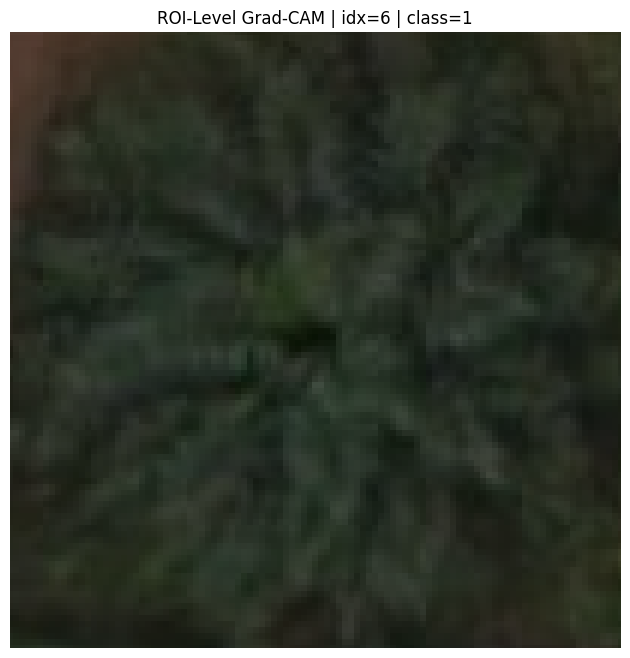

In [ ]:
# Healthy
heat = gradcam_frcnn_roi(rcnn_model, test_ds, device, idx=6, target_class=1)

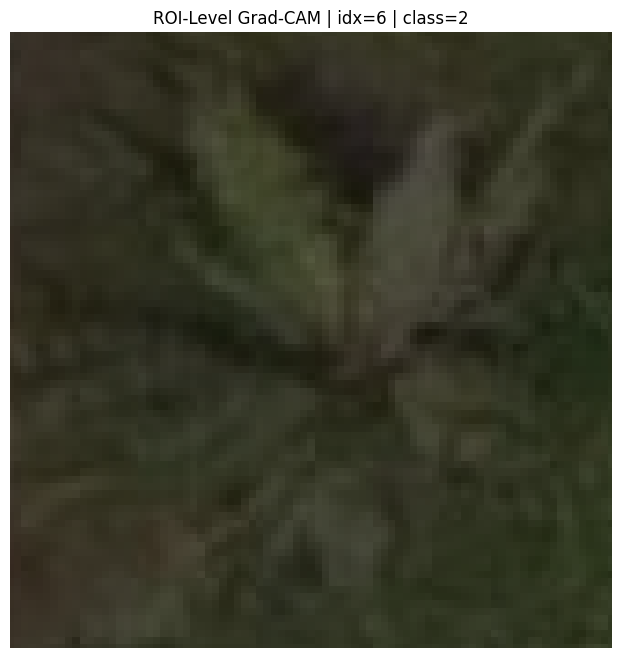

In [ ]:
# Unhealthy
heat = gradcam_frcnn_roi(rcnn_model, test_ds, device, idx=6, target_class=2)

### **YOLO11**

In [ ]:
from ultralytics import YOLO

model_dir = os.path.join(base_dir, "model")
YOLO_MODEL_PATH = os.path.join(model_dir, "yolo11n_10_epochs.pt")

oil_palm_tree_health_model = YOLO(YOLO_MODEL_PATH)
oil_palm_tree_health_model.eval()

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C3k2(
        (cv1): Conv(
          (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(48, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_

In [ ]:
# Evaluation Metrics
data_dir_new = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection_new")
data_yaml_new = os.path.join(data_dir_new, "data.yaml")

yolo_results_test = oil_palm_tree_health_model.val(
    data=data_yaml_new,
    split="test",
    imgsz=640,
    conf=0.7,
    iou=0.3,
    plots=True
)

Ultralytics 8.3.245 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3398.1±1064.6 MB/s, size: 168.5 KB)
val: Scanning /content/Oil-Palm-Health-Detection-2_new/new_test/labels.cache... 231 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 231/231 298.9Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 15/15 1.3it/s 11.6s
                   all        231      12750      0.925      0.924      0.956      0.731
               Healthy        230      12564      0.939      0.968      0.983      0.752
             Unhealthy        109        186      0.911       0.88      0.929       0.71
Speed: 3.6ms preprocess, 6.0ms inference, 0.0ms loss, 5.2ms postprocess per image
Results saved to /content/runs/detect/val2
YOLO Test Evaluation Time: 14.34 seconds


In [ ]:
import time
data_dir_new = os.path.join(base_dir, "data", "Oil-Palm-Health-Detection_new")
source_new = os.path.join(data_dir_new, "new_test", "images")

# Timing
start_time = time.perf_counter()

yolo_results = oil_palm_tree_health_model.predict(
    source=source_new,
    imgsz=640,
    conf=0.7,
    iou=0.3,
)

end_time = time.perf_counter()

total_time = end_time - start_time

print(f"YOLO Inference Time (predict): {total_time:.2f} seconds")


image 1/231 /content/Oil-Palm-Health-Detection-2_new/new_test/images/44000_16000_1013_87_jpg.rf.c98991ecc4845010e6202c466dd2f019.jpg: 640x640 82 Healthys, 10.1ms
image 2/231 /content/Oil-Palm-Health-Detection-2_new/new_test/images/44000_16000_1067_1756_jpg.rf.5570fb9e367c49f8a9c19583242c7942.jpg: 640x640 78 Healthys, 8.0ms
image 3/231 /content/Oil-Palm-Health-Detection-2_new/new_test/images/44000_16000_1075_3609_jpg.rf.08d53f12905fa675903c461a94f90039.jpg: 640x640 79 Healthys, 7.9ms
image 4/231 /content/Oil-Palm-Health-Detection-2_new/new_test/images/44000_16000_1121_2878_jpg.rf.6159e27ab4d44e9d295dd00a6a13efeb.jpg: 640x640 51 Healthys, 1 Unhealthy, 7.9ms
image 5/231 /content/Oil-Palm-Health-Detection-2_new/new_test/images/44000_16000_1128_245_jpg.rf.488f434a407228daa530379cc730ed01.jpg: 640x640 80 Healthys, 8.0ms
image 6/231 /content/Oil-Palm-Health-Detection-2_new/new_test/images/44000_16000_114_1996_jpg.rf.72951ecf9429eabcce608ed090c2bcd0.jpg: 640x640 86 Healthys, 1 Unhealthy, 7.9m

In [ ]:
def load_yolo_labels(label_path, img_w, img_h):
    boxes = []
    labels = []

    if not os.path.exists(label_path):
        return torch.empty((0, 4)), torch.empty((0,), dtype=torch.long)

    with open(label_path, "r") as f:
        for line in f:
            cls, xc, yc, w, h = map(float, line.split())
            cls = int(cls)

            x1 = (xc - w / 2) * img_w
            y1 = (yc - h / 2) * img_h
            x2 = (xc + w / 2) * img_w
            y2 = (yc + h / 2) * img_h

            boxes.append([x1, y1, x2, y2])
            labels.append(cls)

    return torch.tensor(boxes), torch.tensor(labels)

In [ ]:
@torch.no_grad()
def compute_yolo_object_level_confusion(
    yolo_results,
    labels_dir,
    class_ids=[0, 1],   # 0=Healthy, 1=Unhealthy
    iou_thresh=0.3,
    conf_thresh=0.7
):
    cm = torch.zeros((len(class_ids), len(class_ids)), dtype=torch.int64)
    class_to_idx = {cid: i for i, cid in enumerate(class_ids)}

    for r in yolo_results:
        img_h, img_w = r.orig_img.shape[:2]
        img_name = os.path.basename(r.path)
        label_path = os.path.join(labels_dir, img_name.replace(".jpg", ".txt"))

        gt_boxes, gt_labels = load_yolo_labels(label_path, img_w, img_h)

        if r.boxes is None:
            continue

        pred_boxes = []
        pred_labels = []
        pred_scores = []

        for box in r.boxes:
            if box.conf.item() < conf_thresh:
                continue
            pred_boxes.append(box.xyxy[0].cpu())
            pred_labels.append(int(box.cls.item()))
            pred_scores.append(box.conf.item())

        if len(pred_boxes) == 0 or gt_boxes.numel() == 0:
            continue

        pred_boxes = torch.stack(pred_boxes)
        pred_labels = torch.tensor(pred_labels)

        ious = box_iou(pred_boxes, gt_boxes)
        matched_gt = set()
        matched_pred = set()

        pairs = torch.nonzero(ious >= iou_thresh, as_tuple=False)
        if pairs.numel() == 0:
            continue

        pair_ious = ious[pairs[:, 0], pairs[:, 1]]
        order = torch.argsort(pair_ious, descending=True)
        pairs = pairs[order]

        for p_idx, g_idx in pairs.tolist():
            if p_idx in matched_pred or g_idx in matched_gt:
                continue

            matched_pred.add(p_idx)
            matched_gt.add(g_idx)

            true_cls = int(gt_labels[g_idx].item())
            pred_cls = int(pred_labels[p_idx].item())

            if true_cls in class_to_idx and pred_cls in class_to_idx:
                cm[class_to_idx[true_cls], class_to_idx[pred_cls]] += 1

    return pd.DataFrame(
        cm.numpy(),
        index=["GT Healthy", "GT Unhealthy"],
        columns=["Pred Healthy", "Pred Unhealthy"]
    )

In [ ]:
labels_dir_new = os.path.join(data_dir_new, "new_test", "labels")

cm_yolo = compute_yolo_object_level_confusion(yolo_results, labels_dir=labels_dir_new,
                                         conf_thresh=0.7, iou_thresh=0.3)

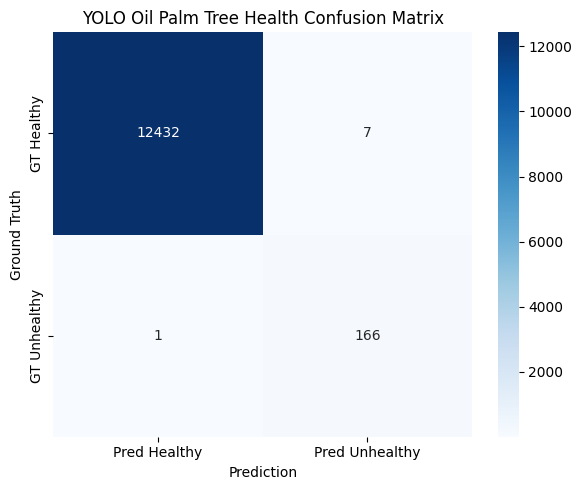

In [ ]:
plt.figure(figsize=(6,5))
sns.heatmap(cm_yolo, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Prediction")
plt.ylabel("Ground Truth")
plt.title("YOLO Oil Palm Tree Health Confusion Matrix")
plt.tight_layout()
plt.show()

In [ ]:
# Draw ground truth boxes
def annotate_labeling(img, label_path, w, h, class_id, class_name):
  if not os.path.exists(label_path):
    return

  with open(label_path, "r") as f:
    lines = f.readlines()

  for line in lines:
    cls, xc, yc, bw, bh = map(float, line.split())
    if int(cls) != class_id:
      continue

    x1 = int((xc - bw / 2) * w)
    y1 = int((yc - bh / 2) * h)
    x2 = int((xc + bw / 2) * w)
    y2 = int((yc + bh / 2) * h)

    # Ground Truth (Green)
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(img, f"GT {class_name}", (x1, y1 - 5),
                cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 255, 0), 2)

In [ ]:
def display_predictions_YOLO(results, labels_dir, class_id, class_name):
    # Filter results that actually have predictions
    filtered_results = []

    for r in results:
        if r.boxes is None:
            continue
        for box in r.boxes:
            if int(box.cls.item()) == class_id:
                filtered_results.append(r)
                break

    if len(filtered_results) == 0:
        print(f"No {class_name} detections found.")
        return

    samples = random.sample(
        filtered_results,
        min(6, len(filtered_results))
    )

    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.flatten()

    for ax, r in zip(axes, samples):
        img = r.orig_img.copy()
        h, w, _ = img.shape

        # Draw Predicted (Red)
        for box in r.boxes:
            if int(box.cls.item()) != class_id:
                continue

            x1, y1, x2, y2 = map(int, box.xyxy[0])
            conf = box.conf.item()

            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(img, f"Pred {class_name} {conf:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

        # Draw Ground Truth (Green)
        img_name = os.path.basename(r.path)
        label_path = os.path.join(
            labels_dir,
            os.path.splitext(img_name)[0] + ".txt"
        )

        annotate_labeling(img, label_path, w, h, class_id, class_name)

        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.set_title(img_name, fontsize=9)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

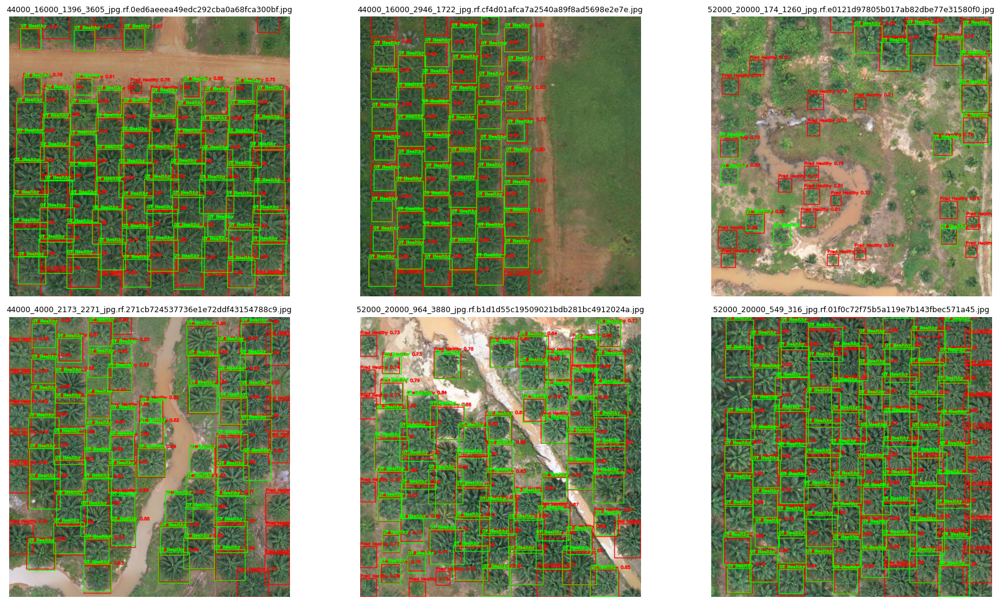

In [ ]:
# Healthy
labels_dir_new = os.path.join(data_dir_new, "new_test", "labels")

display_predictions_YOLO(yolo_results, labels_dir=labels_dir_new,
                         class_id=0, class_name="Healthy")

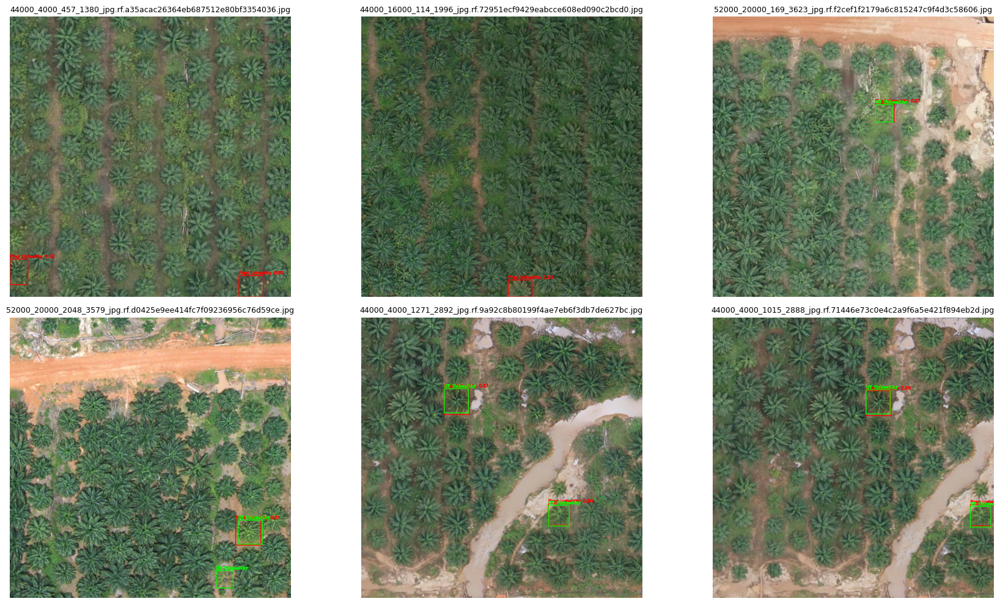

In [ ]:
# Unhealthy
labels_dir_new = os.path.join(data_dir_new, "new_test", "labels")

display_predictions_YOLO(yolo_results, labels_dir=labels_dir_new,
                         class_id=1, class_name="Unhealthy")

## 🧪 **Result Evaluation**

### 🔹 **Faster R-CNN (Two-Stage Detector)**

**1. Detection and Classification Performance**

The performance of the Faster R-CNN model was evaluated on the test set using object-level detection metrics, including a confusion matrix and class-wise precision, recall, and F1-score.

For healthy oil palm trees, the model achieved:
- Precision: 99.05%
- Recall: 99.22%
- F1-score: 99.13%

For unhealthy oil palm trees, the model achieved:
- Precision: 97.21%
- Recall: 93.55%
- F1-score: 95.34%

The confusion matrix indicates that:
- Only a small number of healthy trees were misclassified as unhealthy.
- A limited number of unhealthy trees were not detected (false negatives), remaining below the predefined threshold of 30%.

**2. Interpretability Evaluation (Grad-CAM)**

ROI-level Grad-CAM visualizations were generated for the Faster R-CNN model. The activation maps consistently highlighted regions within the oil palm canopy, including:
- Variations in canopy texture
- Areas exhibiting color irregularities within the crown

These regions correspond spatially with the detected bounding boxes.

**3. Inference Speed**

The inference performance of the Faster R-CNN model was measured on the test set:
- Inference time (predict): approximately 23.0 seconds

### 🔹 **YOLO11 (Single-Stage Detector)**

**1. Detection and Classification Performance**

The performance of the YOLO11 model was evaluated on the test set using standard object detection metrics, including mAP50, a confusion matrix, and evaluation metrics such as precision and recall.

The model achieved an overall mAP50 of 95.6%.

For the healthy class, the evaluation results are:
- Precision: 93.9%
- Recall: 96.8%

For the unhealthy class, the evaluation results are:
- Precision: 91.1%
- Recall: 88.0%

The confusion matrix indicates:
- A moderate level of misclassification between healthy and unhealthy classes.
- A small number of unhealthy trees were not detected, remaining within the predefined acceptable threshold.

**2. Interpretability Evaluation**

ROI-level Grad-CAM visualizations were not generated for the YOLO11 model due to architectural limitations. As such, interpretability assessment for YOLO11 is limited to qualitative inspection of predicted bounding boxes.

**3. Inference Speed**

The inference performance of the YOLO11 model was measured on the test set:
- Inference time (predict): approximately 4.92 seconds

## 🌟 **Intepretation of Result**

This analysis evaluated the effectiveness of Faster R-CNN and YOLO11 for oil palm tree health detection using RGB drone imagery, with a focus on detection accuracy, classification reliability, interpretability, and practical deployment considerations. The results demonstrate that both models are capable of achieving the stated data mining goals; however, they exhibit distinct strengths and limitations that influence their suitability for different operational contexts.

**Model Performance and Practicality**

Faster R-CNN consistently achieved higher object-level classification performance, particularly for the Unhealthy class. Its high precision and recall indicate strong discriminative capability, which is crucial for agricultural monitoring where missed detections of unhealthy trees may delay intervention. The low false negative rate further supports its reliability in identifying diseased or stressed trees. However, these benefits come at the cost of increased training complexity and longer inference time. Faster R-CNN requires a multi-stage training pipeline involving region proposal generation and refinement, resulting in higher computational overhead and reduced practicality for real-time applications.

In contrast, YOLO11 adopts a single-stage, end-to-end architecture that significantly simplifies training and deployment. The Nano variant used in this study prioritizes inference speed and lightweight deployment, achieving substantially faster inference while still meeting all predefined success criteria. Although YOLO11 classification performance for unhealthy trees is slightly lower than that of Faster R-CNN, it remains well above the minimum thresholds, making it suitable for large-scale monitoring tasks where speed and scalability are critical.


**Interpretability and Feature Understanding**

Model interpretability plays a key role in building trust in automated decision-making systems, particularly in precision agriculture. ROI-level Grad-CAM visualizations generated using Faster R-CNN provide qualitative insights into the visual patterns learned by the model. The highlighted regions correspond to biologically meaningful canopy-level features such as texture variation, leaf density, and structural irregularities, which are consistent with agronomic indicators of tree health. This confirms that the model bases its predictions on relevant visual cues rather than background artifacts.

YOLO11, while effective in detection and classification, offers limited interpretability due to architectural constraints. As a result, it is less suitable for applications that require detailed visual explanations or expert validation of model decisions.


**Evaluation Against Success Criteria**

Both models satisfy all core detection and classification success criteria defined at the outset of the study. Notably, both achieve recall rates for the Unhealthy class well above the 70% threshold, ensuring that the majority of unhealthy trees are correctly identified. Faster R-CNN demonstrates superior robustness in this regard, while YOLO11 maintains acceptable performance with the added advantage of speed. The interpretability criterion is fully met by Faster R-CNN and partially met by YOLO11, reinforcing the complementary nature of the two approaches.


**Deployment Considerations and Recommended Strategy**

The results highlight a clear trade-off between accuracy, interpretability, and computational efficiency. Faster R-CNN is best suited for offline analysis, research validation, and decision-support systems where detailed explanations and high diagnostic accuracy are required. YOLO11, particularly in its lightweight Nano configuration, is more appropriate for real-time or near real-time deployment, enabling rapid screening of large plantation areas.

Based on these findings, a hybrid deployment strategy is recommended. YOLO11 can be used for large-scale, real-time screening to quickly identify potentially unhealthy trees, while Faster R-CNN can be applied selectively to flagged regions for detailed analysis and interpretability. This approach leverages the strengths of both models and aligns closely with real-world agricultural monitoring requirements.